In [2]:
#import necessary libraries
import numpy as np
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torch.optim as optim
from tabulate import tabulate
import matplotlib
import urllib
import random
import scipy.ndimage as nd
#fix seed
torch.manual_seed(int("01724711"))
np.random.seed(int("01724711"))

Option 2

Part 1

In [3]:
#download CIFAR10 dataset
train_set = torchvision.datasets.CIFAR10(
root="./",
download=True,
train=True,
transform=transforms.Compose([transforms.ToTensor()]),
)
test_set = torchvision.datasets.CIFAR10(
root="./",
download=True,
train=False,
transform=transforms.Compose([transforms.ToTensor()]),
)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./cifar-10-python.tar.gz to ./
Files already downloaded and verified


In [4]:
#get train_set mean and std
train_mean = train_set.data.mean(axis=(0,1,2))/255
train_std = train_set.data.std(axis=(0,1,2))/255
#print
print("train_mean: ", train_mean)
print("train_std: ", train_std)

train_mean:  [0.49139968 0.48215841 0.44653091]
train_std:  [0.24703223 0.24348513 0.26158784]


In [5]:
#download CIFAR10 dataset with normalization
train_set = torchvision.datasets.CIFAR10(
root="./",
download=True,
train=True,
transform=transforms.Compose([transforms.ToTensor(),transforms.Normalize(train_mean, train_std)]),
)
test_set = torchvision.datasets.CIFAR10(
root="./",
download=True,
train=False,
transform=transforms.Compose([transforms.ToTensor(),transforms.Normalize(train_mean, train_std)]),
)

Files already downloaded and verified
Files already downloaded and verified


In [6]:
if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

In [7]:
def load_data(batch_size, train_set, test_set):
    trainloader = torch.utils.data.DataLoader(train_set, batch_size=batch_size, shuffle=True)
    testloader = torch.utils.data.DataLoader(test_set, batch_size=batch_size, shuffle=True)
    return trainloader, testloader

def train_epoch(trainloader, net, optimizer, criterion):
    net.train()
    running_loss = 0.0
    for i, data in enumerate(trainloader, 0):
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    return running_loss / len(trainloader)

def test_epoch(testloader, net, criterion):
    net.eval()
    total_loss = 0.0
    total_error = 0.0
    num_samples = 0
    with torch.no_grad():
        for data in testloader:
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = net(inputs)
            loss = criterion(outputs, labels)
            total_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs.data, 1)
            total_error += (predicted != labels).sum().item()
            num_samples += inputs.size(0)
    avg_loss = total_loss / num_samples
    error_rate = total_error / num_samples
    return avg_loss, error_rate

Task 1

In [8]:
# Define hyperparameters
batch_size = 128
lr = 0.01
n_epochs = 20

class Net(nn.Module):
    def __init__(self, ):
        super(Net, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)    
        self.fc1 = nn.Linear(in_features=128*4*4, out_features=512)
        self.fc2 = nn.Linear(in_features=512, out_features=10)
        
    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = self.conv2(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = self.conv3(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = x.view(-1, 128*4*4)
        x = self.fc1(x)
        x = self.relu(x)
        
        x = self.fc2(x)
        
        return x


net = Net().cuda()

# Record the final train and test losses
train_losses = []
test_losses = []
test_errors = []

# Define the optimizer and criterion
optimizer = optim.SGD(net.parameters(), lr=lr, momentum=0.9)
criterion = nn.CrossEntropyLoss()

# Load the data
trainloader, testloader = load_data(batch_size, train_set=train_set, test_set=test_set)

# Train and test the model for n_epochs
for epoch in range(1, n_epochs+1):
    # Train for one epoch
    train_loss = train_epoch(trainloader, net, optimizer, criterion)
    # Test for one epoch
    test_loss, test_err = test_epoch(testloader, net, criterion)

    # Record the final train and test losses
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    test_errors.append(test_err)
    
    # Print the results for this epoch
    print(f'Epoch: {epoch:03} | Train Loss: {train_loss:.04f} | Test Loss: {test_loss:.04f} | Test Error: {test_err:.04f}')

Epoch: 001 | Train Loss: 1.7528 | Test Loss: 1.3909 | Test Error: 0.5039
Epoch: 002 | Train Loss: 1.2221 | Test Loss: 1.0820 | Test Error: 0.3769
Epoch: 003 | Train Loss: 0.9873 | Test Loss: 0.9248 | Test Error: 0.3203
Epoch: 004 | Train Loss: 0.8287 | Test Loss: 0.8459 | Test Error: 0.2910
Epoch: 005 | Train Loss: 0.7012 | Test Loss: 0.7903 | Test Error: 0.2772
Epoch: 006 | Train Loss: 0.6009 | Test Loss: 0.7644 | Test Error: 0.2603
Epoch: 007 | Train Loss: 0.5079 | Test Loss: 0.8093 | Test Error: 0.2698
Epoch: 008 | Train Loss: 0.4146 | Test Loss: 0.8563 | Test Error: 0.2725
Epoch: 009 | Train Loss: 0.3313 | Test Loss: 0.8161 | Test Error: 0.2562
Epoch: 010 | Train Loss: 0.2462 | Test Loss: 0.8486 | Test Error: 0.2405
Epoch: 011 | Train Loss: 0.1794 | Test Loss: 0.9381 | Test Error: 0.2546
Epoch: 012 | Train Loss: 0.1243 | Test Loss: 1.0497 | Test Error: 0.2459
Epoch: 013 | Train Loss: 0.0999 | Test Loss: 1.1339 | Test Error: 0.2467
Epoch: 014 | Train Loss: 0.0736 | Test Loss: 1.1762

After 20 epochs we do make sure to obtain a test error of below 0.4 at 0.2507. We observe overfitting and finish with a generalisation gap of just over 1.5.

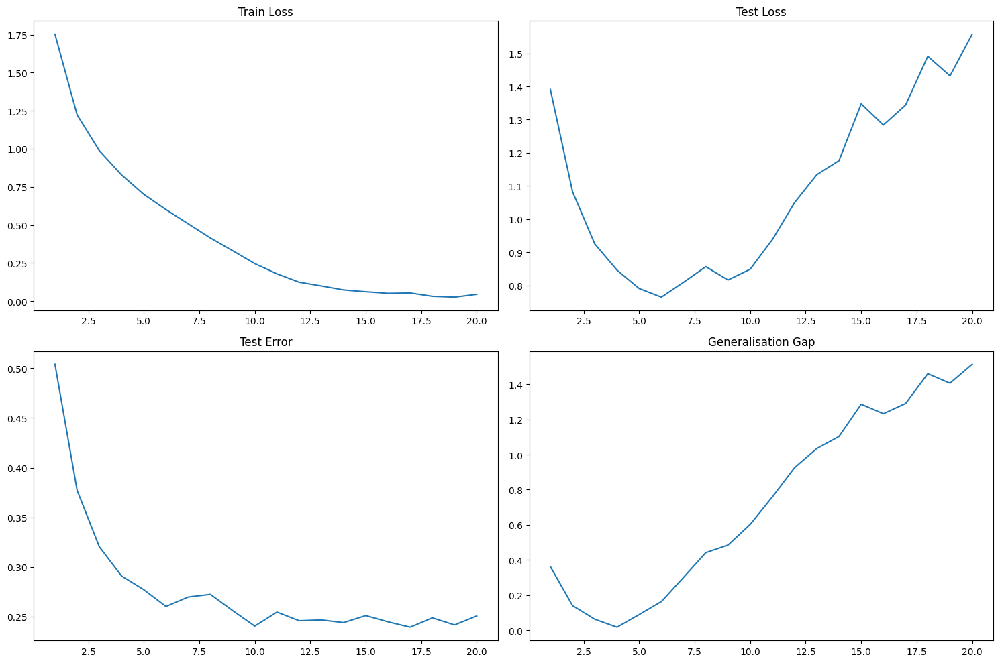

In [9]:
#plot four graphs on same figure for train loss, test loss and test error and generalisation gap against epochs
fig, ax = plt.subplots(2, 2, figsize=(15, 10))

ax[0,0].plot(range(1, len(train_losses)+1),[float(n) for n in train_losses])
ax[0,1].plot(range(1, len(test_losses)+1),[float(n) for n in test_losses])
ax[1,0].plot(range(1, len(test_errors)+1),[float(n) for n in test_errors])
ax[1,1].plot(range(1, len(train_losses)+1),np.abs(np.array([float(n) for n in train_losses])-np.array([float(n) for n in test_losses])))
ax[0,0].set_title('Train Loss')
ax[0,1].set_title('Test Loss')
ax[1,0].set_title('Test Error')
ax[1,1].set_title('Generalisation Gap')
plt.tight_layout()

Task 2

Dropout is a regularization technique that helps prevent overfitting in neural networks. It works by randomly dropping out (setting to zero) a certain percentage of the output values of each layer during training. This helps prevent the network from relying too heavily on any one set of weights and encourages the learning of more robust features.

Adding dropout layers to a neural network involves including them in the model architecture, typically after each fully connected layer. In PyTorch, dropout can be implemented using the torch.nn.Dropout module, which takes a probability value as an argument that determines the probability of an element being zeroed out.

Dropout is often not applied directly after pooling layers because it can disrupt the learning of useful spatial patterns that have been learned by the network. The reason for this is that pooling layers are designed to reduce the spatial dimensionality of the data, while dropout layers randomly mask units during training. This means that if dropout is applied directly after a pooling layer, it may mask out useful information that was learned by the pooling layer, and prevent the network from effectively learning spatial patterns.

In [16]:
# Define hyperparameters
batch_size = 128
lr = 0.01
n_epochs = 20

class Net(nn.Module):
    def __init__(self, ):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, padding=1)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1) 
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        self.fc1 = nn.Linear(in_features=128*4*4, out_features=512)
        self.fc2 = nn.Linear(in_features=512, out_features=10)
        self.dropout = nn.Dropout(p=0.6)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = self.conv2(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = self.conv3(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = x.view(-1, 128*4*4)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.dropout(x)
        x = self.fc2(x)
        
        return x


net = Net().cuda()

# Record the final train and test losses
train_losses = []
test_losses = []
test_errors = []

# Define the optimizer and criterion
optimizer = optim.SGD(net.parameters(), lr=lr, momentum=0.9)
criterion = nn.CrossEntropyLoss()

# Load the data
trainloader, testloader = load_data(batch_size, train_set=train_set, test_set=test_set)

# Train and test the model for n_epochs
for epoch in range(1, n_epochs+1):
    # Train for one epoch
    train_loss = train_epoch(trainloader, net, optimizer, criterion)
    # Test for one epoch
    test_loss, test_err = test_epoch(testloader, net, criterion)

    # Record the final train and test losses
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    test_errors.append(test_err)
    
    # Print the results for this epoch
    print(f'Epoch: {epoch:03} | Train Loss: {train_loss:.04f} | Test Loss: {test_loss:.04f} | Test Error: {test_err:.04f}')

Epoch: 001 | Train Loss: 1.8206 | Test Loss: 1.4386 | Test Error: 0.5258
Epoch: 002 | Train Loss: 1.3439 | Test Loss: 1.1373 | Test Error: 0.4036
Epoch: 003 | Train Loss: 1.1205 | Test Loss: 0.9594 | Test Error: 0.3369
Epoch: 004 | Train Loss: 0.9637 | Test Loss: 0.9081 | Test Error: 0.3181
Epoch: 005 | Train Loss: 0.8483 | Test Loss: 0.8160 | Test Error: 0.2805
Epoch: 006 | Train Loss: 0.7655 | Test Loss: 0.7489 | Test Error: 0.2622
Epoch: 007 | Train Loss: 0.6937 | Test Loss: 0.7433 | Test Error: 0.2545
Epoch: 008 | Train Loss: 0.6291 | Test Loss: 0.7219 | Test Error: 0.2517
Epoch: 009 | Train Loss: 0.5767 | Test Loss: 0.6726 | Test Error: 0.2293
Epoch: 010 | Train Loss: 0.5301 | Test Loss: 0.6653 | Test Error: 0.2250
Epoch: 011 | Train Loss: 0.4843 | Test Loss: 0.6758 | Test Error: 0.2322
Epoch: 012 | Train Loss: 0.4398 | Test Loss: 0.6668 | Test Error: 0.2211
Epoch: 013 | Train Loss: 0.3971 | Test Loss: 0.6564 | Test Error: 0.2167
Epoch: 014 | Train Loss: 0.3617 | Test Loss: 0.7127

With the same number of epochs we see that with dropout we have a consistent decrease in test error with the final error having 13.9609% decrease. We also observe that the magnitude of overfitting is much reduced to a final generalisation gap of 0.6 rather than 1.5. We have sufficient evidence to suggest that dropout does improve performance and helps reduce the magnitude of overfitting.

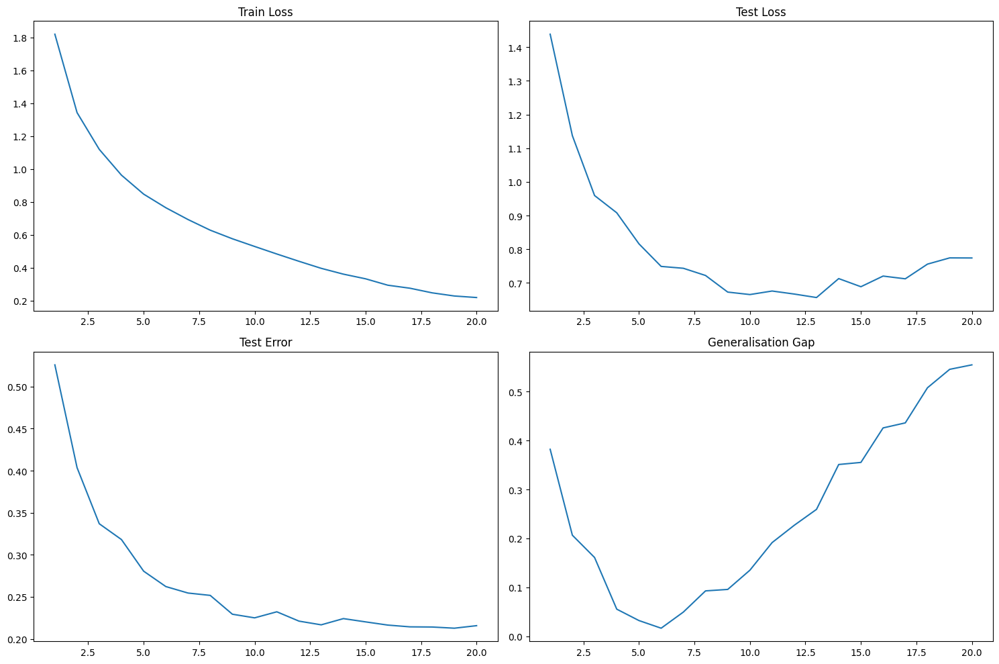

In [17]:
#plot four graphs on same figure for train loss, test loss and test error and generalisation gap against epochs
fig, ax = plt.subplots(2, 2, figsize=(15, 10))

ax[0,0].plot(range(1, len(train_losses)+1),[float(n) for n in train_losses])
ax[0,1].plot(range(1, len(test_losses)+1),[float(n) for n in test_losses])
ax[1,0].plot(range(1, len(test_errors)+1),[float(n) for n in test_errors])
ax[1,1].plot(range(1, len(train_losses)+1),np.abs(np.array([float(n) for n in train_losses])-np.array([float(n) for n in test_losses])))
ax[0,0].set_title('Train Loss')
ax[0,1].set_title('Test Loss')
ax[1,0].set_title('Test Error')
ax[1,1].set_title('Generalisation Gap')
plt.tight_layout()

Task 3

BatchNorm, short for Batch Normalization, is a technique used to normalize the inputs of each layer of a neural network to help with the optimization process. Specifically, it normalizes the output of a previous layer by subtracting the mean and dividing by the variance of the batch of inputs. This helps prevent the outputs of each layer from getting too large or too small, which can lead to issues with vanishing or exploding gradients during training. BatchNorm also introduces two learnable parameters, scale and shift, which are used to adjust the normalized output. These parameters allow the network to learn the optimal scale and shift for each layer during training.

To add BatchNorm layers to our CNN, we can use torch.nn.BatchNorm2d, which normalizes the output of a 2D convolutional layer across the batch dimension and spatial dimensions (height and width). We can insert these layers after each convolutional layer in our model.

Batch normalization is typically applied after the convolutional layers because it helps to normalize the inputs to the activation function in each layer. This helps to mitigate the internal covariate shift problem by ensuring that the inputs to each layer have zero mean and unit variance.

Additionally, batch normalization has been shown to improve the convergence of the neural network during training, allowing for faster and more stable training. It is also known to have a regularizing effect, similar to dropout, which can improve generalization performance of the model.

Therefore, it is common practice to apply batch normalization after the convolutional layers and before the activation function.

In [20]:
# Define hyperparameters
batch_size = 128
lr = 0.01
n_epochs = 20

class Net(nn.Module):
    def __init__(self, ):
        super(Net, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(32)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(64)
        
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        self.bn3 = nn.BatchNorm2d(128)
        
        self.fc1 = nn.Linear(in_features=128*4*4, out_features=512)
        self.fc2 = nn.Linear(in_features=512, out_features=10)
        
        self.dropout = nn.Dropout(p=0.6)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = self.conv3(x)
        x = self.bn3(x)
        x = self.relu(x)
        x = self.pool(x)
        
        x = x.view(-1, 128*4*4)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.dropout(x)
        
        x = self.fc2(x)
        
        return x


net = Net().cuda()

# Record the final train and test losses
train_losses = []
test_losses = []
test_errors = []

# Define the optimizer and criterion
optimizer = optim.SGD(net.parameters(), lr=lr, momentum=0.9)
criterion = nn.CrossEntropyLoss()

# Load the data
trainloader, testloader = load_data(batch_size, train_set=train_set, test_set=test_set)

# Train and test the model for n_epochs
for epoch in range(1, n_epochs+1):
    # Train for one epoch
    train_loss = train_epoch(trainloader, net, optimizer, criterion)
    # Test for one epoch
    test_loss, test_err = test_epoch(testloader, net, criterion)

    # Record the final train and test losses
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    test_errors.append(test_err)
    
    # Print the results for this epoch
    print(f'Epoch: {epoch:03} | Train Loss: {train_loss:.04f} | Test Loss: {test_loss:.04f} | Test Error: {test_err:.04f}')

Epoch: 001 | Train Loss: 1.4735 | Test Loss: 1.1413 | Test Error: 0.4096
Epoch: 002 | Train Loss: 1.1295 | Test Loss: 1.0183 | Test Error: 0.3648
Epoch: 003 | Train Loss: 0.9753 | Test Loss: 0.8825 | Test Error: 0.3077
Epoch: 004 | Train Loss: 0.8754 | Test Loss: 0.8292 | Test Error: 0.2867
Epoch: 005 | Train Loss: 0.7951 | Test Loss: 0.7510 | Test Error: 0.2518
Epoch: 006 | Train Loss: 0.7275 | Test Loss: 0.6949 | Test Error: 0.2401
Epoch: 007 | Train Loss: 0.6719 | Test Loss: 0.6567 | Test Error: 0.2288
Epoch: 008 | Train Loss: 0.6094 | Test Loss: 0.6565 | Test Error: 0.2270
Epoch: 009 | Train Loss: 0.5743 | Test Loss: 0.6679 | Test Error: 0.2273
Epoch: 010 | Train Loss: 0.5332 | Test Loss: 0.6241 | Test Error: 0.2138
Epoch: 011 | Train Loss: 0.4907 | Test Loss: 0.6227 | Test Error: 0.2106
Epoch: 012 | Train Loss: 0.4590 | Test Loss: 0.6900 | Test Error: 0.2329
Epoch: 013 | Train Loss: 0.4202 | Test Loss: 0.6356 | Test Error: 0.2162
Epoch: 014 | Train Loss: 0.3869 | Test Loss: 0.6286

Again we see consistent improvement when adding in batch normalisation layers. The final test error is a 11.2193% decrease from the previous model final test error. Further, the magnitude of the generalisation gap is again also decreased to 0.42 vs 0.5. We have sufficient evidence to suggest that batch normalisation does improve performance and helps reduce the magnitude of overfitting.

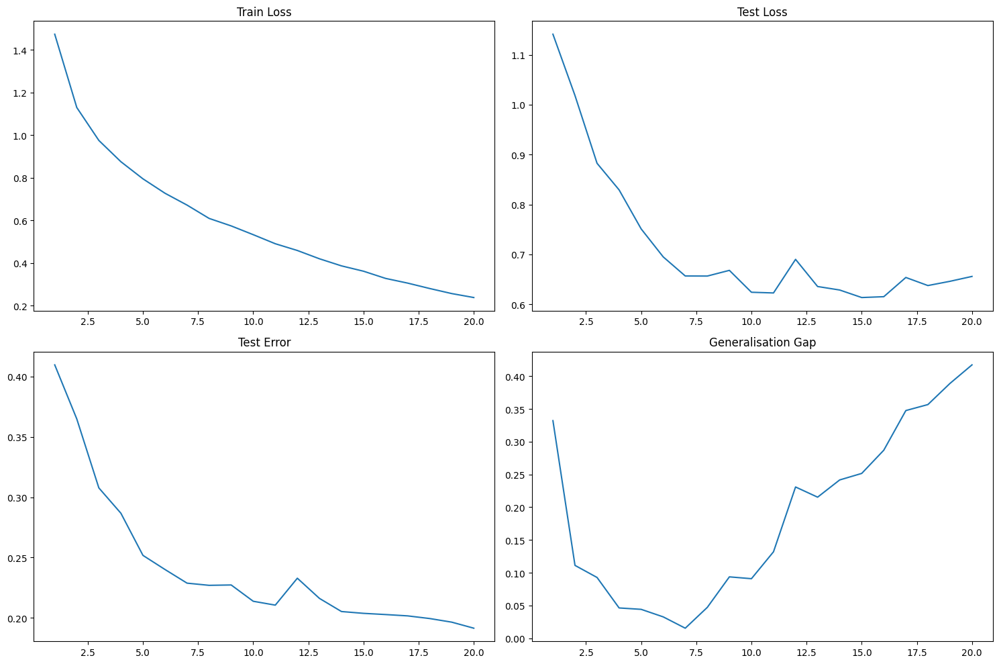

In [22]:
#plot four graphs on same figure for train loss, test loss and test error and generalisation gap against epochs
fig, ax = plt.subplots(2, 2, figsize=(15, 10))

ax[0,0].plot(range(1, len(train_losses)+1),[float(n) for n in train_losses])
ax[0,1].plot(range(1, len(test_losses)+1),[float(n) for n in test_losses])
ax[1,0].plot(range(1, len(test_errors)+1),[float(n) for n in test_errors])
ax[1,1].plot(range(1, len(train_losses)+1),np.abs(np.array([float(n) for n in train_losses])-np.array([float(n) for n in test_losses])))
ax[0,0].set_title('Train Loss')
ax[0,1].set_title('Test Loss')
ax[1,0].set_title('Test Error')
ax[1,1].set_title('Generalisation Gap')
plt.tight_layout()

Part 2

Task 1

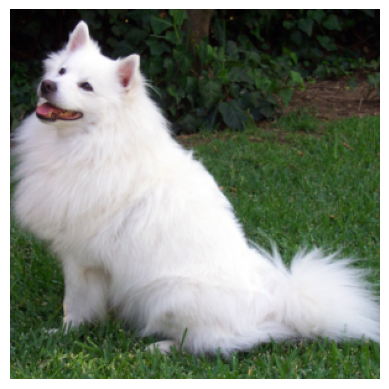

In [ ]:
url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg","dog.jpg")
try: urllib.URLopener().retrieve(url, filename)
except: urllib.request.urlretrieve(url, filename)
# sample execution (requires torchvision)
from PIL import Image
from torchvision import transforms
input_image = Image.open(filename)
preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]),
])
input_tensor = preprocess(input_image)
input_batch = input_tensor.unsqueeze(0) # create a minibatch as expected by the model
# Print initial image
mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]
original = input_batch.detach().squeeze(0).permute(1,2,0).numpy() * std + mean
plt.imshow(original.clip(0,1))
plt.axis('off')
plt.show()


Task 2

In [ ]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'inception_v3', pretrained=True)
model.eval()

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [ ]:
outputs= []
def hook(module, input, output):
    outputs.append(output)

This code defines a hook function that takes in three arguments - a module, an input tensor, and an output tensor. The function appends the output tensor to a global list called outputs.

In PyTorch, hooks are functions that can be registered to be called whenever a module performs a forward or backward pass. They allow you to inspect and modify the inputs, outputs, and gradients of the module, which can be useful for debugging, monitoring, or implementing custom behavior.

In this specific case, the hook function is used to extract the outputs of certain layers of a neural network during a forward pass. By registering this hook function to these layers, every time the forward pass reaches one of them, the output tensor is appended to the outputs list.

After the forward pass, the outputs list will contain all the output tensors of the chosen layers, which can be further analyzed or used for backpropagation.

Task 3

The register_forward_hook method can be used to register a hook function to be called when the forward pass reaches a specific layer in the model.

In the given code, model.maxpool1 refers to the maxpool1 layer of the model. register_forward_hook(hook) registers the hook function to be called whenever the forward pass reaches the maxpool1 layer.

h = model.maxpool1.register_forward_hook(hook) assigns the hook object to h for the maxpool1 layer.

h.remove() removes the hook from the model's maxpool1 layer. This can be useful if you want to temporarily add a hook for debugging or visualization purposes, but don't want it to affect subsequent forward passes.

In [ ]:
#example
h = model.maxpool1.register_forward_hook(hook)
h.remove()

Task 4

In [ ]:
def deepdream(model, input_batch, layer, iterations, lr):    
    # Register a forward hook to obtain the output of the chosen layer
    outputs= []
    def hook(module, input, output):
      outputs.append(output)

    h = layer.register_forward_hook(hook)
    
    # Perform gradient ascent to optimize the input image
    input_batch.requires_grad_(True)
    for i in range(iterations):
        # Forward pass to obtain the model output
        model.zero_grad()
        output = model(input_batch)
        
        # Compute the loss as the L2 norm of the activations from the chosen layer
        loss = torch.norm(outputs[-1])
        
        # Compute the gradients of the loss with respect to the input image
        loss.backward()
        
        # Scale the gradients by their absolute average
        g = input_batch.grad
        g = g/torch.abs(g).mean()
        
        # Update the input image using gradient ascent
        input_batch.data += lr * g
        
        # Zero out the gradients
        input_batch.grad.zero_()
    
    # Remove the forward hook and return the final image
    h.remove()
    return input_tensor.detach().squeeze(0).permute(1,2,0).numpy()

Task 5

First run the algorithm and present the results for one specific configuration to check that it works correctly.

The mean and std values are normalization constants that were used to normalize the input image in the preprocessing stage. Here, the code reverses the normalization process, so that the output image is in the same scale as the input image. 

In [ ]:
input_tensor = preprocess(input_image)
input_batch = input_tensor.unsqueeze(0) 
output1 = deepdream(model, input_batch, model.Mixed_7c, 3, 0.1)

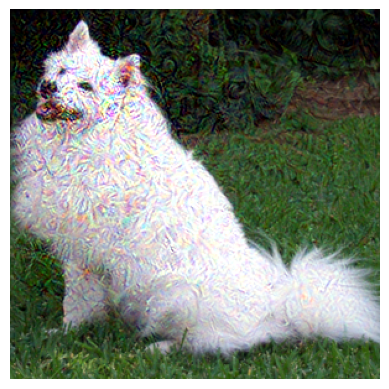

In [ ]:
mean=np.array([0.485, 0.456, 0.406])
std=np.array([0.229, 0.224, 0.225])
output1 = output1 * std + mean
plt.imshow(output1.clip(0,1))
plt.axis('off')
plt.show()

Now we visualise the results for a variety of layers and iteration numbers whilst keeping learning rate constant.

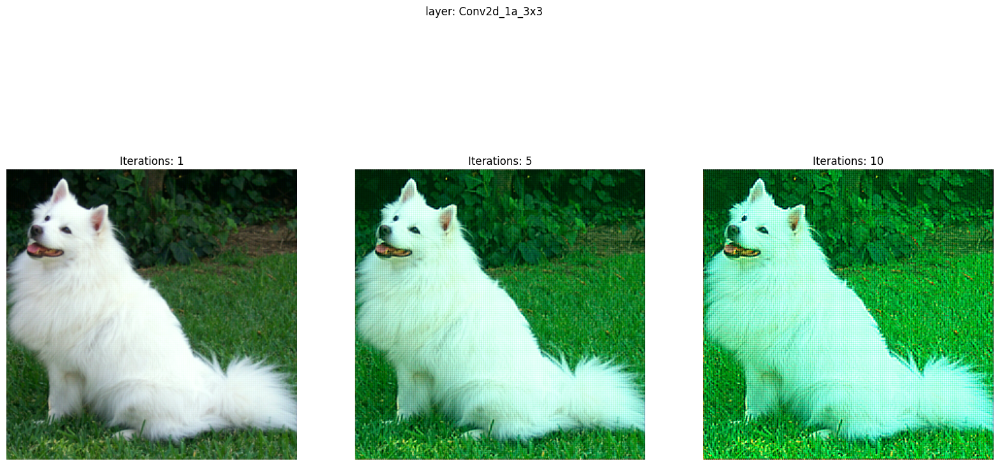

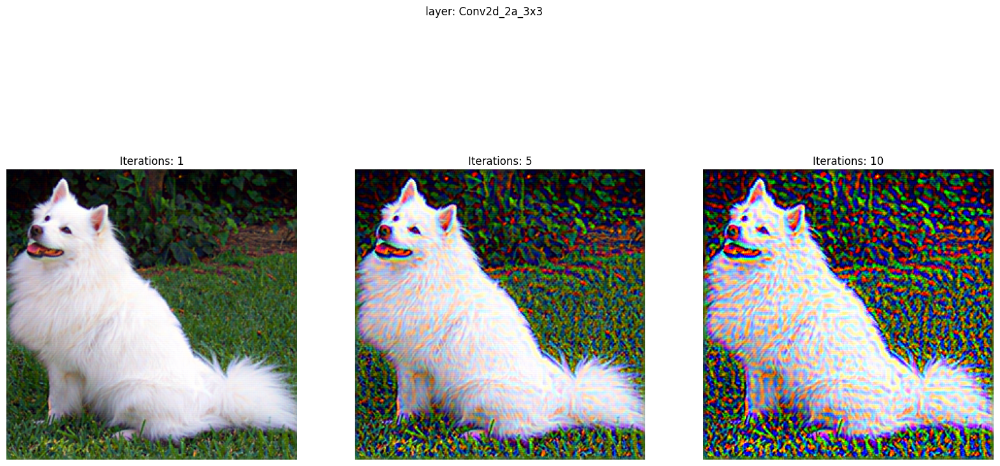

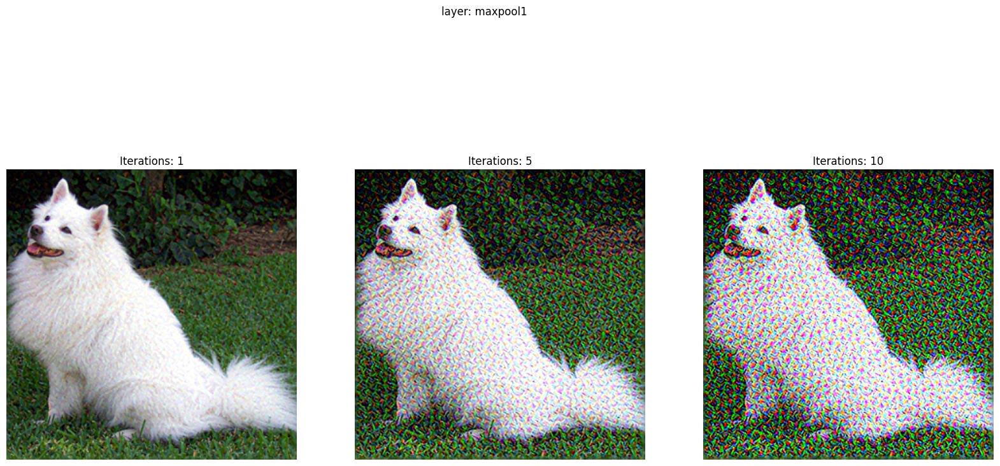

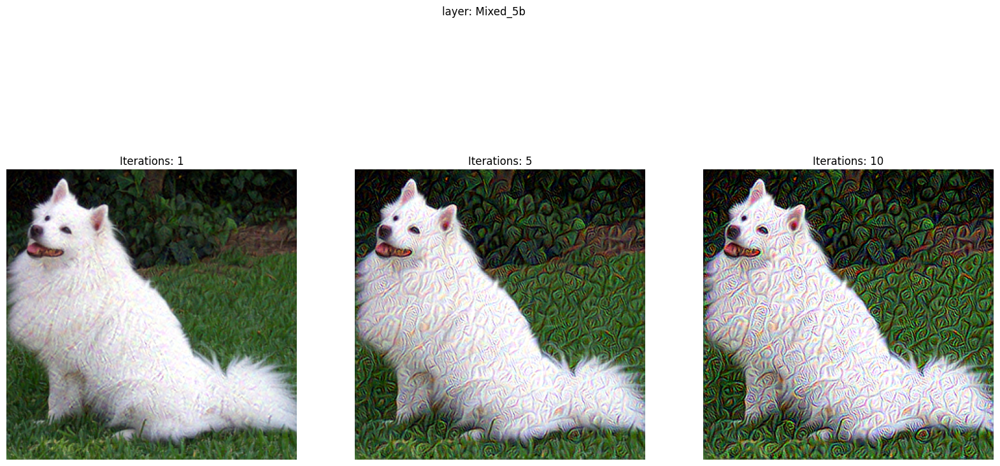

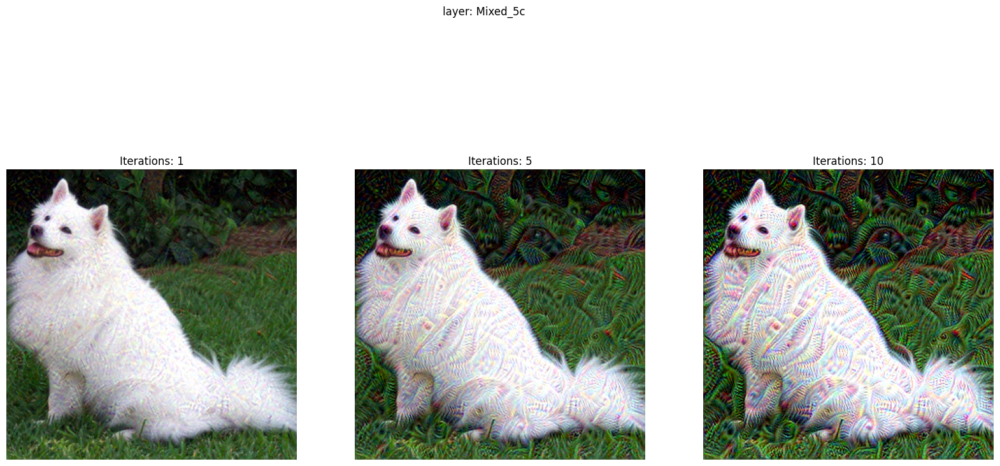

...

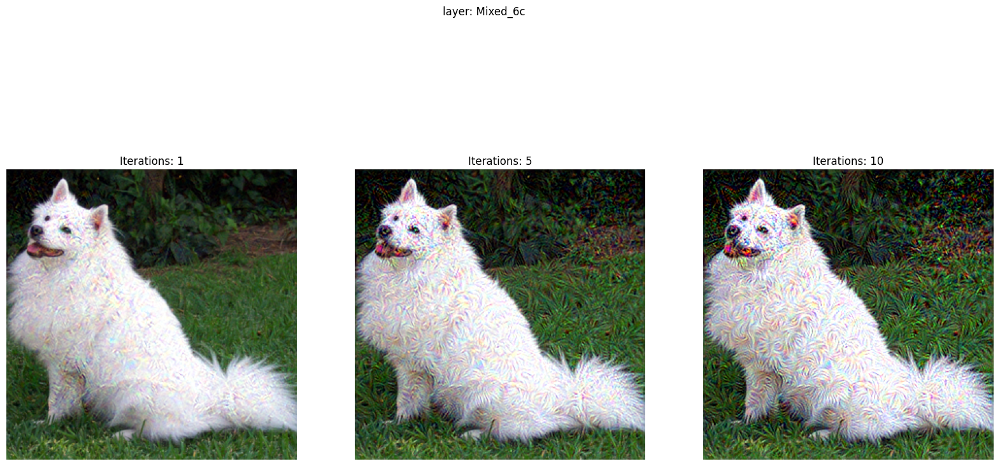

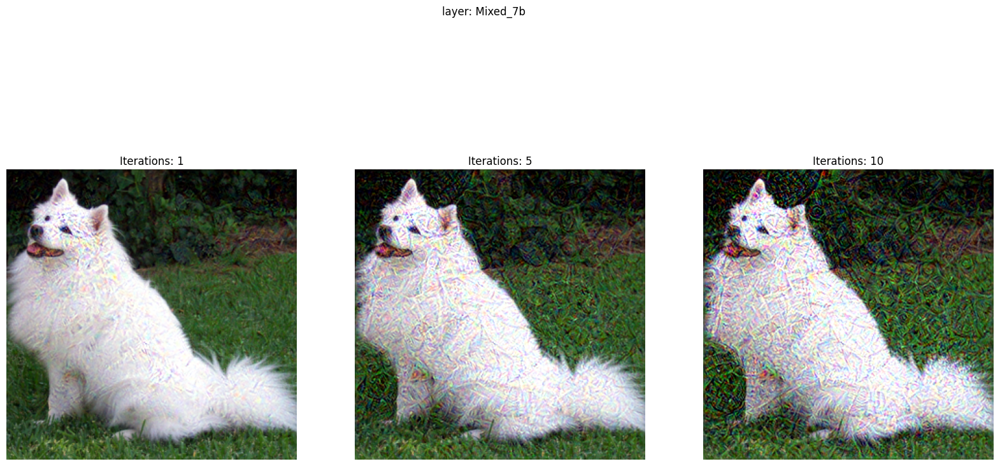

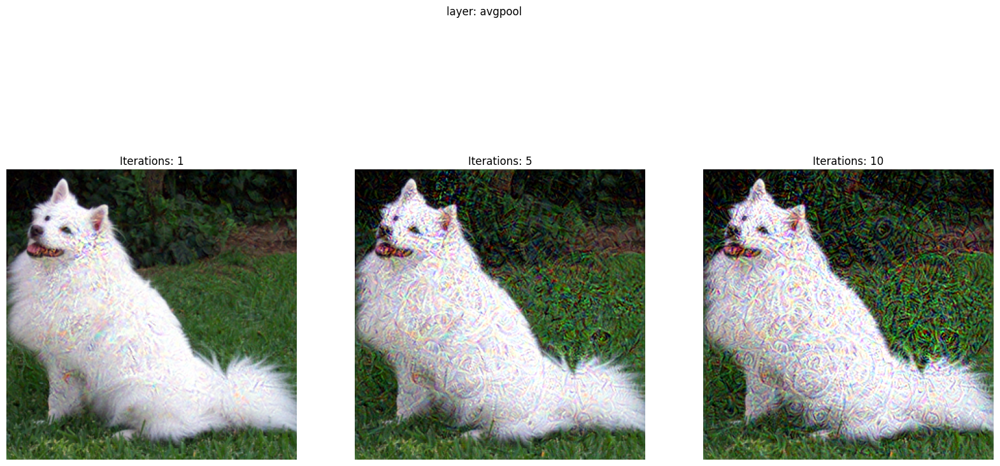

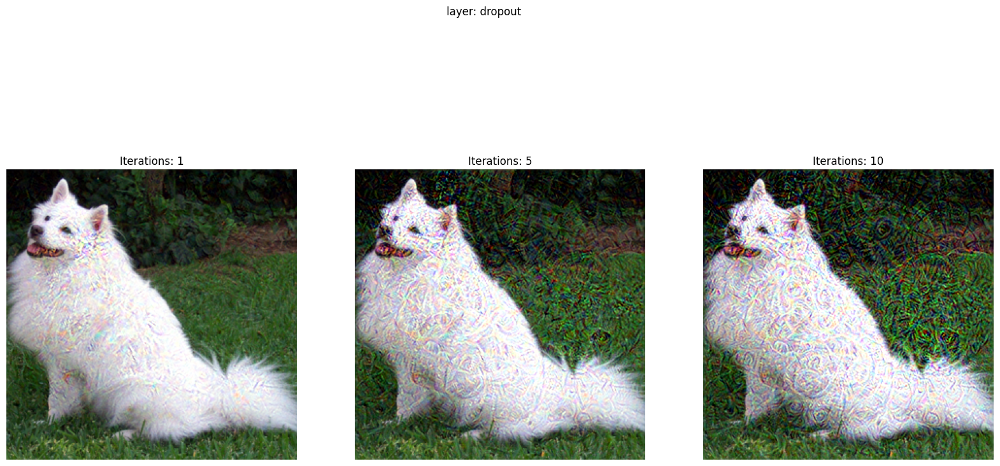

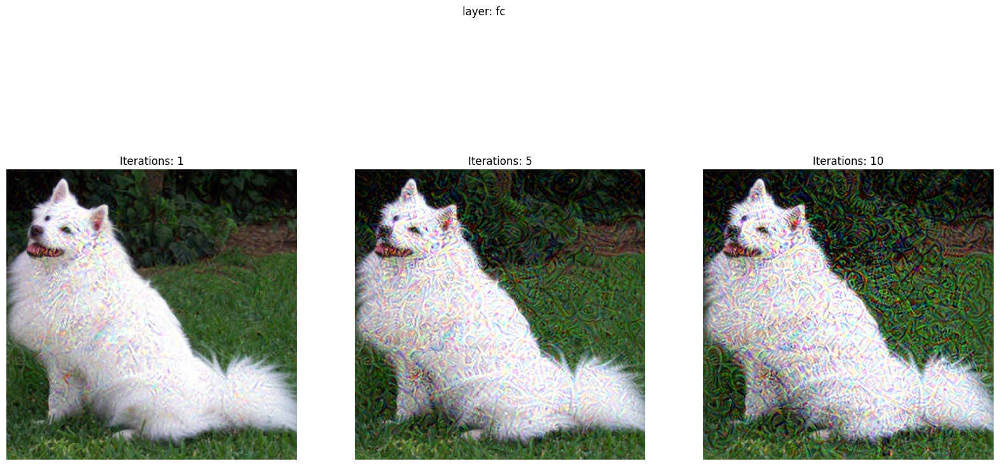

In [ ]:
# Define layers to visualize
layers = [model.Conv2d_1a_3x3, model.Conv2d_2a_3x3, model.maxpool1, model.Mixed_5b, model.Mixed_5c, model.Mixed_6a, model.Mixed_6b, model.Mixed_6c, model.Mixed_7b, model.avgpool, model.dropout, model.fc]

# Name of each layer (for plot title)
str_layers = ['Conv2d_1a_3x3', 'Conv2d_2a_3x3', 'maxpool1', 'Mixed_5b', 'Mixed_5c', 'Mixed_6a', 'Mixed_6b', 'Mixed_6c', 'Mixed_7b', 'avgpool', 'dropout', 'fc']

# Number of iterations to apply DeepDream for each plot
num_iters = [1, 5, 10]

# Learning rate for optimization
lr = 0.1

# Loop over all layers
for j, layer in enumerate(layers):
    
    # Create subplots with 1 row and 3 columns
    fig, ax = plt.subplots(1, 3, figsize=(20, 10))
    
    # Set the title of the figure to the name of the current layer
    fig.suptitle(f'layer: {str_layers[j]}')
    
    # Loop over all iteration values
    for i, num_iter in enumerate(num_iters):
        
        # Preprocess the input image (normalize and convert to tensor)
        input_tensor = preprocess(input_image)
        
        # Add an extra dimension to simulate batch processing
        input_batch = input_tensor.unsqueeze(0)
        
        # Apply DeepDream to the current layer and number of iterations
        output = deepdream(model, input_batch, layer, num_iter, lr)
        
        # Convert the output tensor to a NumPy array and denormalize
        output = output * std + mean
        
        # Display the output image in the current subplot
        ax[i].imshow(output.clip(0, 1))
        
        # Set the title of the subplot to the number of iterations
        ax[i].set_title(f"Iterations: {num_iter}")
        
        # Hide the axis
        ax[i].axis('off')
        
    # Show the current figure
    plt.show()


The choice of layers and the number of optimization steps can have a significant impact on the resulting deep dream images.

Different layers in a neural network capture different types of features at different levels of abstraction. Lower layers, such as 'Conv2d_1a_3x3', typically capture simpler features like colours, edges and shapes, while higher layers like 'Mixed_7b' capture more complex features like object parts and textures. Therefore, using different layers can result in deep dream images that highlight different types of features. For example, using lower layers may result in images with more geometric patterns, while using higher layers may result in images with more recognizable objects or textures.

The number of optimization steps determines the level of detail and complexity in the resulting deep dream image. A small number of steps may result in simpler images with fewer features, while a larger number of steps can lead to more detailed and complex images with more features. However, using too many optimization steps can also lead to overfitting, where the image becomes overly focused on specific features or patterns and loses its overall coherence.

In summary, choosing different layers and adjusting the number of optimization steps can allow for a wide range of creative exploration and experimentation in generating deep dream images.

Task 6

In [ ]:
def deepdream_multilayer(model, input_batch, layers, iterations, lr):    
    # Register multiple forward hooks to obtain the output of the chosen layers
    outputs = {layer: [] for layer in layers}
    hooks = []
    for layer in layers:
        def hook_fn(layer, input, output):
            outputs[layer].append(output)
        hook = layer.register_forward_hook(hook_fn)
        hooks.append(hook)
    
    # Perform gradient ascent to optimize the input image
    input_batch.requires_grad_(True)
    for i in range(iterations):
        # Forward pass to obtain the model output
        model.zero_grad()
        output = model(input_batch)
        
        # Compute the loss as the L2 norm of the activations from the chosen layers
        loss = sum(torch.norm(outputs[layer][-1]) for layer in layers)
        
        # Compute the gradients of the loss with respect to the input image
        loss.backward()
        
        # Scale the gradients by their absolute average
        g = input_batch.grad
        g = g/torch.abs(g).mean()
        
        # Update the input image using gradient ascent
        input_batch.data += lr * g
        
        # Zero out the gradients
        input_batch.grad.zero_()
    
    # Remove the forward hook and return the final image
    for hook in hooks:
      hook.remove()
    return input_batch.detach()

In [ ]:
#example to test that code works correclty
input_tensor = preprocess(input_image)
input_batch = input_tensor.unsqueeze(0) # create a minibatch as expected by the model~

output1 = deepdream_multilayer(model, input_batch, [model.Mixed_7b, model.Mixed_7c], 3, 0.1)

In [ ]:
def plot_dream(output1):
  # remove batch dimension and rearrange dimensions to (height, width, channels)
  output1 = output1.squeeze(0).permute(1,2,0).numpy()
  
  # rescale and shift the pixel values to be in the range [0,1]
  output1 = output1 * std + mean
  
  # display the image
  plt.imshow(output1.clip(0,1))
  plt.axis('off')
  plt.show()



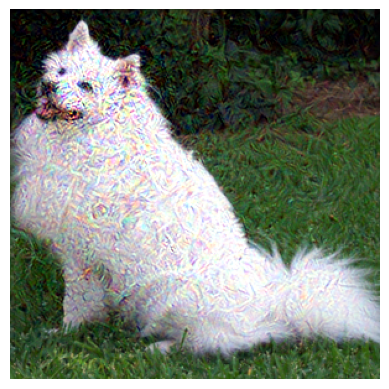

In [ ]:
plot_dream(output1)

Task 7

This code implements the deep dream algorithm using multiple octaves to create more detailed and complex dream-like images. The input image is first downsampled to create multiple smaller versions of the image, each of which is referred to as an octave.

The algorithm then applies the deep dream algorithm to each octave, starting from the smallest octave and working up to the original size of the image. The idea is to create a dream-like image at each octave that captures increasingly detailed features of the input image.

To achieve this, the code starts with the smallest octave and applies the deep dream algorithm using the deepdream_multilayer function (which takes as input a pre-trained neural network model, an input image, a list of layers to extract features from, and parameters for the optimization process). The output image is then subtracted from the original octave to obtain a "detail" image, which captures the difference between the original and the dream image at that octave.

The detail image is then upsampled to the size of the next larger octave and added to the original octave to create a new input image for the next iteration of the deep dream algorithm. This process is repeated for each octave until the original size of the image is reached.

Overall, the use of multiple octaves and the accumulation of detail images allows the algorithm to create dream-like images that capture increasingly complex and detailed features of the input image.

In [ ]:
def deep_dream_octaves(model, input_batch, layers, iterations, lr, octave_scale, num_octaves):

    # Extract image representations for each octave
    octaves = [input_batch]
    for _ in range(num_octaves - 1):
        octaves.append(nd.zoom(octaves[-1], (1, 1, 1 / octave_scale, 1 / octave_scale), order=1))

    detail = np.zeros_like(octaves[-1])
    for octave, octave_base in enumerate(octaves[::-1]):
        if octave > 0:
            # Upsample detail to new octave dimension
            detail = nd.zoom(detail, np.array(octave_base.shape) / np.array(detail.shape), order=1)
        # Add deep dream detail from previous octave to new base
        input_image = octave_base + detail
        input_image = torch.autograd.Variable(torch.FloatTensor(input_image), requires_grad=True)
        # Get new deep dream image
        dreamed_image = deepdream_multilayer(model, input_image, layers, iterations, lr)
        # Extract deep dream details
        detail = dreamed_image - octave_base

    return dreamed_image

In [ ]:
#upload own image of Taj Mahal
from google.colab import files
uploaded = files.upload()

Saving taj_mahal.jpg to taj_mahal (1).jpg


In [ ]:
input_image = Image.open('taj_mahal.jpg')

# Convert the image to RGB format if it's not already in that format
if input_image.mode != 'RGB':
    image = input_image.convert('RGB')

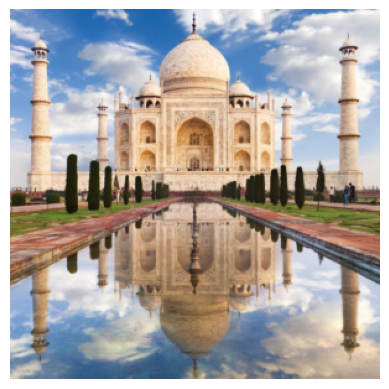

In [ ]:
input_tensor = preprocess(input_image)
input_batch = input_tensor.unsqueeze(0)
#plot original image
plot_dream(input_batch)

I like this dream image most since it is quite unique and rather different from anything we might see in our daily lives. It is visually intriguing and captivating, and the novelty of the imagery is appealing. Further, this dream image evokes strong emotional responses, and I enjoy the way they I feel when looking at it. Using this specific configuration we see the patterns that are created are vibrant and clear. I particularly like how the tower cupolas form into eyes. Looks spookily similar to something like the eye of sauron. 

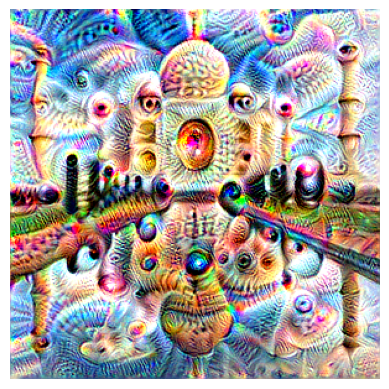

In [ ]:
# enhanced dream version
output1 = deep_dream_octaves(model, input_batch, [model.Mixed_6a, model.maxpool2], 10, 0.1, 1.4, 3)
plot_dream(output1)